# Agentic Search 🔍

## Introduction
This Jupyter Notebook demonstrates the use of the `langchain library and its associated tools to perform searches and extract information`. The primary focus is on utilizing the `TavilySearchResults tool` to fetch search results and process them effectively. Additionally, the notebook includes examples of web scraping using the requests and BeautifulSoup libraries.

### Import Required Libraries

In [1]:
# Import necessary modules from the langchain library
from langchain_core.messages import AnyMessage, SystemMessage, HumanMessage, ToolMessage
from langchain.chat_models import ChatOpenAI  # Correct import
from langchain_community.tools.tavily_search import TavilySearchResults

In [2]:
# Import necessary modules from the langgraph library
from langgraph.graph import StateGraph, END
from typing import TypedDict, Annotated
import operator

In [3]:
# Import necessary modules from rich library that helps to improve the readability of nested dictionary outputs
from rich import print
from rich.pretty import Pretty

### Load Environment Variables
Load the environment variables from a .env file to access the OpenAI API key.

In [ ]:
# Import the required library
from dotenv import load_dotenv
import os

# Load environment variables
load_dotenv()

# Print the Tavily API key (masked)
print(f"TAVILY_API_KEY: {os.getenv('TAVILY_API_KEY')[:5]}*****")


TAVILY_API_KEY: tvly-*****

In [5]:
# Initialize TavilySearchResults tool
tool = TavilySearchResults(max_results=4) #increased number of results
print(type(tool))
print(tool.name)

<class 'langchain_community.tools.tavily_search.tool.TavilySearchResults'>

tavily_search_results_json

The original Notebook was using the `TavilyClient` with a `search method`, see the following snippet code.
```
# libraries
from dotenv import load_dotenv
import os
from tavily import TavilyClient

# load environment variables from .env file
_ = load_dotenv()

# connect
client = TavilyClient(api_key=os.environ.get("TAVILY_API_KEY")) 

# run search
result = client.search("What is in Nvidia's new Blackwell GPU?",
                       include_answer=True)

# print the answer
result["answer"]

```

However, instead to use the `TavilyClient`, let's use `TavilySearchResults` class from the `langchain_community.tools.tavily_search` module. Therefore, we need also to take into consideration that the `TaviliSearchResults` class does not have a `search`method. Let's explare the attubutes and methods that this class can offer instead of `search'

### Connecting to Tavily Client

In [6]:

# Connect to Tavily using environment variables from .env file
client = TavilySearchResults(api_key=os.environ.get("TAVILY_API_KEY"))

In [7]:
# Inspect the TavilySearchResults class
print(dir(client))

# Print in a pretty format 
print(Pretty(dir(client)))

[
    'InputType',
    'OutputType',
    '__abstractmethods__',
    '__annotations__',
    '__call__',
    '__class__',
    '__class_getitem__',
    '__class_vars__',
    '__copy__',
    '__deepcopy__',
    '__delattr__',
    '__dict__',
    '__dir__',
    '__doc__',
    '__eq__',
    '__fields__',
    '__fields_set__',
    '__format__',
    '__ge__',
    '__get_pydantic_core_schema__',
    '__get_pydantic_json_schema__',
    '__getattr__',
    '__getattribute__',
    '__getstate__',
    '__gt__',
    '__hash__',
    '__init__',
    '__init_subclass__',
    '__iter__',
    '__le__',
    '__lt__',
    '__module__',
    '__ne__',
    '__new__',
    '__or__',
    '__orig_bases__',
    '__parameters__',
    '__pretty__',
    '__private_attributes__',
    '__pydantic_complete__',
    '__pydantic_computed_fields__',
    '__pydantic_core_schema__',
    '__pydantic_custom_init__',
    '__pydantic_decorators__',
    '__pydantic_extra__',
    '__pydantic_fields__',
    '__pydantic_fields_set__',
    '__pydantic_generic_metadata__',
    '__pydantic_init_subclass__',
    '__pydantic_parent_namespace__',
    '__pydantic_post_init__',
    '__pydantic_private__',
    '__pydantic_root_model__',
    '__pydantic_serializer__',
    '__pydantic_validator__',
    '__reduce__',
    '__reduce_ex__',
    '__replace__',
    '__repr__',
    '__repr_args__',
    '__repr_name__',
    '__repr_recursion__',
    '__repr_str__',
    '__rich_repr__',
    '__ror__',
    '__setattr__',
    '__setstate__',
    '__signature__',
    '__sizeof__',
    '__slots__',
    '__str__',
    '__subclasshook__',
    '__weakref__',
    '_abatch_with_config',
    '_abc_impl',
    '_acall_with_config',
    '_arun',
    '_atransform_stream_with_config',
    '_batch_with_config',
    '_calculate_keys',
    '_call_with_config',
    '_check_frozen',
    '_copy_and_set_values',
    '_get_value',
    '_iter',
    '_parse_input',
    '_run',
    '_to_args_and_kwargs',
    '_transform_stream_with_config',
    'abatch',
    'abatch_as_completed',
    'ainvoke',
    'api_wrapper',
    'args',
    'args_schema',
    'arun',
    'as_tool',
    'assign',
    'astream',
    'astream_events',
    'astream_log',
    'atransform',
    'batch',
    'batch_as_completed',
    'bind',
    'callback_manager',
    'callbacks',
    'config_schema',
    'config_specs',
    'configurable_alternatives',
    'configurable_fields',
    'construct',
    'copy',
    'description',
    'dict',
    'exclude_domains',
    'from_orm',
    'get_config_jsonschema',
    'get_graph',
    'get_input_jsonschema',
    'get_input_schema',
    'get_lc_namespace',
    'get_name',
    'get_output_jsonschema',
    'get_output_schema',
    'get_prompts',
    'handle_tool_error',
    'handle_validation_error',
    'include_answer',
    'include_domains',
    'include_images',
    'include_raw_content',
    'input_schema',
    'invoke',
    'is_lc_serializable',
    'is_single_input',
    'json',
    'lc_attributes',
    'lc_id',
    'lc_secrets',
    'map',
    'max_results',
    'metadata',
    'model_computed_fields',
    'model_config',
    'model_construct',
    'model_copy',
    'model_dump',
    'model_dump_json',
    'model_extra',
    'model_fields',
    'model_fields_set',
    'model_json_schema',
    'model_parametrized_name',
    'model_post_init',
    'model_rebuild',
    'model_validate',
    'model_validate_json',
    'model_validate_strings',
    'name',
    'output_schema',
    'parse_file',
    'parse_obj',
    'parse_raw',
    'pick',
    'pipe',
    'raise_deprecation',
    'response_format',
    'return_direct',
    'run',
    'schema',
    'schema_json',
    'search_depth',
    'stream',
    'tags',
    'to_json',
    'to_json_not_implemented',
    'tool_call_schema',
    'transform',
    'update_forward_refs',
    'validate',
    'verbose',
    'with_alisteners',
    'with_config',
    'with_fallbacks',
    'with_listeners',
    'with_retry',
    'with_types'
]

[
    'InputType',
    'OutputType',
    '__abstractmethods__',
    '__annotations__',
    '__call__',
    '__class__',
    '__class_getitem__',
    '__class_vars__',
    '__copy__',
    '__deepcopy__',
    '__delattr__',
    '__dict__',
    '__dir__',
    '__doc__',
    '__eq__',
    '__fields__',
    '__fields_set__',
    '__format__',
    '__ge__',
    '__get_pydantic_core_schema__',
    '__get_pydantic_json_schema__',
    '__getattr__',
    '__getattribute__',
    '__getstate__',
    '__gt__',
    '__hash__',
    '__init__',
    '__init_subclass__',
    '__iter__',
    '__le__',
    '__lt__',
    '__module__',
    '__ne__',
    '__new__',
    '__or__',
    '__orig_bases__',
    '__parameters__',
    '__pretty__',
    '__private_attributes__',
    '__pydantic_complete__',
    '__pydantic_computed_fields__',
    '__pydantic_core_schema__',
    '__pydantic_custom_init__',
    '__pydantic_decorators__',
    '__pydantic_extra__',
    '__pydantic_fields__',
    '__pydantic_fields_set__',
    '__pydantic_generic_metadata__',
    '__pydantic_init_subclass__',
    '__pydantic_parent_namespace__',
    '__pydantic_post_init__',
    '__pydantic_private__',
    '__pydantic_root_model__',
    '__pydantic_serializer__',
    '__pydantic_validator__',
    '__reduce__',
    '__reduce_ex__',
    '__replace__',
    '__repr__',
    '__repr_args__',
    '__repr_name__',
    '__repr_recursion__',
    '__repr_str__',
    '__rich_repr__',
    '__ror__',
    '__setattr__',
    '__setstate__',
    '__signature__',
    '__sizeof__',
    '__slots__',
    '__str__',
    '__subclasshook__',
    '__weakref__',
    '_abatch_with_config',
    '_abc_impl',
    '_acall_with_config',
    '_arun',
    '_atransform_stream_with_config',
    '_batch_with_config',
    '_calculate_keys',
    '_call_with_config',
    '_check_frozen',
    '_copy_and_set_values',
    '_get_value',
    '_iter',
    '_parse_input',
    '_run',
    '_to_args_and_kwargs',
    '_transform_stream_with_config',
    'abatch',
    'abatch_as_completed',
    'ainvoke',
    'api_wrapper',
    'args',
    'args_schema',
    'arun',
    'as_tool',
    'assign',
    'astream',
    'astream_events',
    'astream_log',
    'atransform',
    'batch',
    'batch_as_completed',
    'bind',
    'callback_manager',
    'callbacks',
    'config_schema',
    'config_specs',
    'configurable_alternatives',
    'configurable_fields',
    'construct',
    'copy',
    'description',
    'dict',
    'exclude_domains',
    'from_orm',
    'get_config_jsonschema',
    'get_graph',
    'get_input_jsonschema',
    'get_input_schema',
    'get_lc_namespace',
    'get_name',
    'get_output_jsonschema',
    'get_output_schema',
    'get_prompts',
    'handle_tool_error',
    'handle_validation_error',
    'include_answer',
    'include_domains',
    'include_images',
    'include_raw_content',
    'input_schema',
    'invoke',
    'is_lc_serializable',
    'is_single_input',
    'json',
    'lc_attributes',
    'lc_id',
    'lc_secrets',
    'map',
    'max_results',
    'metadata',
    'model_computed_fields',
    'model_config',
    'model_construct',
    'model_copy',
    'model_dump',
    'model_dump_json',
    'model_extra',
    'model_fields',
    'model_fields_set',
    'model_json_schema',
    'model_parametrized_name',
    'model_post_init',
    'model_rebuild',
    'model_validate',
    'model_validate_json',
    'model_validate_strings',
    'name',
    'output_schema',
    'parse_file',
    'parse_obj',
    'parse_raw',
    'pick',
    'pipe',
    'raise_deprecation',
    'response_format',
    'return_direct',
    'run',
    'schema',
    'schema_json',
    'search_depth',
    'stream',
    'tags',
    'to_json',
    'to_json_not_implemented',
    'tool_call_schema',
    'transform',
    'update_forward_refs',
    'validate',
    'verbose',
    'with_alisteners',
    'with_config',
    'with_fallbacks',
    'with_listeners',
    'with_retry',
    'with_types'
]

**Explanation output** Is seems like that  `the TavilySearchResults` class has a `run` method which might be used to perform the `search`. 

### Example search 

In [8]:

# run search
result = client.run("What is in Nvidia's new Blackwell GPU?", include_answer=True)

# print the answer
print(result["answer"])

TypeError: list indices must be integers or slices, not str

**Explanation output** The run method likely return a list and not a  dictionary. Let's inspect the result and print it to understand its structure. 

In [9]:

# Example: Run a search query and inspect the results
result = client.run("What is in Nvidia's new Blackwell GPU?", include_answer=True)

# Print the result to understand its structure
#print(result)

print(Pretty(result))

[
    {
        'url': 
'https://www.hyperstack.cloud/blog/thought-leadership/everything-you-need-to-know-about-the-nvidia-blackwell-gpus',
        'content': 'NVIDIA Blackwell GPUs are powered by six revolutionary technologies that will enable AI 
training and real-time LLM inference for models scaling up to 10 trillion parametres. Based on the Blackwell 
architecture NVIDIA, the NVIDIA B200 Tensor Core GPU delivers a massive leap forward in speeding up inference 
workloads, making real-time performance a possibility for resource-intensive and multitrillion-parameter language 
models. To help accelerate the development of Blackwell-based servers from its partner network, NVIDIA announced 
NVIDIA HGX B200, a server board that links eight B200 GPUs through high-speed interconnects to develop the world’s 
most powerful x86 generative AI platforms. The Blackwell Architecture NVIDIA is powered by six revolutionary 
technologies that will enable AI training and real-time LLM inference for models scaling up to 10 trillion 
parametres:'
    },
    {
        'url': 
'https://www.tomshardware.com/pc-components/gpus/nvidia-blackwell-rtx-50-series-gpus-everything-we-know',
        'content': 'Nvidia Blackwell and GeForce RTX 50-Series GPUs: Specifications, release dates, pricing, and 
everything we know (updated) | Tom\'s Hardware Nvidia Blackwell and GeForce RTX 50-Series GPUs: Specifications, 
release dates, pricing, and everything we know (updated) The next-generation Nvidia Blackwell GPU architecture and 
RTX 50-series GPUs are coming, basically on schedule. One of the surprising announcements at GTC 2024 was that 
Blackwell B200 will use the TSMC 4NP node — "4nm Nvidia Performance," or basically a tuned/tweaked variation of the
N4 node used on the RTX 40-series. With RTX 40-series making widespread use of 16-pin, that means Blackwell will be
the third generation of Nvidia GPUs to at least partially adopt the standard.'
    },
    {
        'url': 'https://en.wikipedia.org/wiki/Blackwell_(microarchitecture)',
        'content': 'At the Graphics Technology Conference (GTC) on March 18, 2024, Nvidia officially announced the 
Blackwell architecture with focus placed on its B100 and B200 datacenter accelerators and associated products, such
as the eight-GPU HGX B200 board and the 72-GPU NVL72 rack-scale system.[11] Nvidia CEO Jensen Huang said that with 
Blackwell, "we created a processor for the generative AI era" and emphasized the overall Blackwell platform 
combining Blackwell accelerators with Nvidia\'s ARM-based Grace CPU.[12][13] Nvidia touted endorsements of 
Blackwell from the CEOs of Google, Meta, Microsoft, OpenAI and Oracle.[13] The keynote did not mention gaming.'
    },
    {
        'url': 'https://www.theverge.com/2024/3/18/24105157/nvidia-blackwell-gpu-b200-ai',
        'content': 'Nvidia reveals Blackwell B200 GPU, the ‘world’s most powerful chip’ for AI | The Verge Nvidia 
reveals Blackwell B200 GPU, the ‘world’s most powerful chip’ for AI Nvidia is counting on companies to buy large 
quantities of these GPUs, of course, and is packaging them in larger designs, like the GB200 NVL72, which plugs 36 
CPUs and 72 GPUs into a single liquid-cooled rack for a total of 720 petaflops of AI training performance or 1,440 
petaflops (aka 1.4 exaflops) of inference. We don’t expect to hear anything about new gaming GPUs today, as this 
news is coming out of Nvidia’s GPU Technology Conference, which is usually almost entirely focused on GPU computing
and AI, not gaming.'
    },
    {
        'url': 
'https://nvidianews.nvidia.com/news/nvidia-blackwell-platform-arrives-to-power-a-new-era-of-computing',
        'content': 'Certain statements in this press release including, but not limited to, statements as to: the 
benefits, impact, performance, features, and availability of NVIDIA’s products and technologies, including NVIDIA 
Blackwell platform, Blackwell GPU architecture, Resilience Technologies, Custom Tensor Core technology, NV

**Explanation output** The result is a list of dictionaries, each containing url and content keys. To extract and pront the answer, it is possible to iterate over the list and access the content key of each dictionary. 

In [10]:

# run search
result = client.run("What is in Nvidia's new Blackwell GPU?", include_answer=True)

# Extract and print the content from the search results
for item in result:
    #print(item['content'])
    print(Pretty(item['content']))

'NVIDIA Blackwell GPUs are powered by six revolutionary technologies that will enable AI training and real-time LLM
inference for models scaling up to 10 trillion parametres. Based on the Blackwell architecture NVIDIA, the NVIDIA 
B200 Tensor Core GPU delivers a massive leap forward in speeding up inference workloads, making real-time 
performance a possibility for resource-intensive and multitrillion-parameter language models. To help accelerate 
the development of Blackwell-based servers from its partner network, NVIDIA announced NVIDIA HGX B200, a server 
board that links eight B200 GPUs through high-speed interconnects to develop the world’s most powerful x86 
generative AI platforms. The Blackwell Architecture NVIDIA is powered by six revolutionary technologies that will 
enable AI training and real-time LLM inference for models scaling up to 10 trillion parametres:'

'Nvidia Blackwell and GeForce RTX 50-Series GPUs: Specifications, release dates, pricing, and everything we know 
(updated) | Tom\'s Hardware Nvidia Blackwell and GeForce RTX 50-Series GPUs: Specifications, release dates, 
pricing, and everything we know (updated) The next-generation Nvidia Blackwell GPU architecture and RTX 50-series 
GPUs are coming, basically on schedule. One of the surprising announcements at GTC 2024 was that Blackwell B200 
will use the TSMC 4NP node — "4nm Nvidia Performance," or basically a tuned/tweaked variation of the N4 node used 
on the RTX 40-series. With RTX 40-series making widespread use of 16-pin, that means Blackwell will be the third 
generation of Nvidia GPUs to at least partially adopt the standard.'

'At the Graphics Technology Conference (GTC) on March 18, 2024, Nvidia officially announced the Blackwell 
architecture with focus placed on its B100 and B200 datacenter accelerators and associated products, such as the 
eight-GPU HGX B200 board and the 72-GPU NVL72 rack-scale system.[11] Nvidia CEO Jensen Huang said that with 
Blackwell, "we created a processor for the generative AI era" and emphasized the overall Blackwell platform 
combining Blackwell accelerators with Nvidia\'s ARM-based Grace CPU.[12][13] Nvidia touted endorsements of 
Blackwell from the CEOs of Google, Meta, Microsoft, OpenAI and Oracle.[13] The keynote did not mention gaming.'

'Nvidia reveals Blackwell B200 GPU, the ‘world’s most powerful chip’ for AI | The Verge Nvidia reveals Blackwell 
B200 GPU, the ‘world’s most powerful chip’ for AI Nvidia is counting on companies to buy large quantities of these 
GPUs, of course, and is packaging them in larger designs, like the GB200 NVL72, which plugs 36 CPUs and 72 GPUs 
into a single liquid-cooled rack for a total of 720 petaflops of AI training performance or 1,440 petaflops (aka 
1.4 exaflops) of inference. We don’t expect to hear anything about new gaming GPUs today, as this news is coming 
out of Nvidia’s GPU Technology Conference, which is usually almost entirely focused on GPU computing and AI, not 
gaming.'

'Certain statements in this press release including, but not limited to, statements as to: the benefits, impact, 
performance, features, and availability of NVIDIA’s products and technologies, including NVIDIA Blackwell platform,
Blackwell GPU architecture, Resilience Technologies, Custom Tensor Core technology, NVIDIA TensorRT-LLM, NeMo 
Megatron framework, NVLink, NVIDIA GB200 Grace Blackwell Superchip, B200 Tensor Core GPUs, NVIDIA Grace CPU, NVIDIA
H100 Tensor Core GPU, NVIDIA Quantum-X800 InfiniBand and Spectrum-X800 Ethernet platforms, NVIDIA GB200 NVL72, 
NVIDIA BlueField-3 data processing units, DGX SuperPOD, HGX B200, Quantum-2 InfiniBand and Spectrum-X Ethernet 
platforms, BlueField-3 DPUs, NVIDIA DGX Cloud, NVIDIA AI Enterprise, and NVIDIA NIM inference microservices; our 
goal of enabling transformative breakthroughs like deep learning and AI; Blackwell GPUs being the engine to power a
new industrial revolution; our ability to realize the promise of AI for every industry as we working with the most 
dynamic companies in the world; our collaborations and partnerships with third parties and the benefits and impacts
thereof; third parties who will offer or use our products, services and infrastructures and who will deliver 
servers based on our products; and the ability of the customers of global leaders in engineering simulation to use 
generative AI and accelerated computing to bring products to market faster, at lower cost and with higher energy 
efficiency are forward-looking statements that are subject to risks and uncertainties that could cause results to 
be materially different than expectations.'

## Regular search

In [11]:
# Define a query for regular search
city = "Amsterdam"  # choose location (try to change to your own city!)

query = f"""
    what is the current weather in {city}?
    Should I travel there today?
    "weather.com"
"""

**Note** To be able to proceed, it is required to install the `duckduckgo_search library`.  
- The `duckduckgo_search library`is a Python library that allows you to perform web searches using the DuckDuckGo search engine programmatically. It provides a simple API for querying DuckDuckGo and retrieving search results, including links, titles, and snippets of information, without tracking or storing user data.
-  This can be installed through the terminal with the commannd 
```py
py -m pip install duckduckgo-search 
```

In [12]:
# Imports the `requests` library for making HTTP requests (unused in the given code snippet).
import requests

# Imports BeautifulSoup from the `bs4` library for parsing and scraping HTML (also unused here).
from bs4 import BeautifulSoup

# Imports `DDGS` from the `duckduckgo_search` library to perform DuckDuckGo searches.
from duckduckgo_search import DDGS

# Imports the `re` library for regular expression operations (unused in the code snippet).
import re

# Creates an instance of `DDGS`, which provides methods to perform DuckDuckGo searches.
ddg = DDGS()

def search(query, max_results=6):
    # Defines a function `search` to perform a DuckDuckGo text search.
    # Parameters:
    # - `query`: The search query string.
    # - `max_results`: The maximum number of search results to retrieve (default is 6).
    try:
        results = ddg.text(query, max_results=max_results) # Attempts to fetch search results using the `text` method from the `DDGS` instance.
        return [i["href"] for i in results] # Extracts the `href` (link) from each result and returns a list of URLs.
    except Exception as e:
        print(f"returning previous results due to exception reaching ddg.")
        results = [ # cover case where DDG rate limits due to high deeplearning.ai volume
            "https://weather.com/weather/today/l/USCA0987:1:US",
            "https://weather.com/weather/hourbyhour/l/54f9d8baac32496f6b5497b4bf7a277c3e2e6cc5625de69680e6169e7e38e9a8",
        ]
        return results  # Returns the fallback list of results.


for i in search(query): # Iterates through the list of search results (URLs) returned by the `search` function.
    print(i)  # Prints each URL to the console.

https://weather.com/weather/today/l/a0a48c0f8630d7e60cc5d03bf2dc2d039cad87e8dfdb8fc476a43473a6ff7e17

http://www.google.com/search?hl=en&q=what+is+the+current+weather+in+Amsterdam?+Should+I+travel+there+today?+"weathe
r.com"

https://weather.com/weather/today/l/Invalides+Île+de+France+France?canonicalCityId=c2fbb2eb8b0f9ebb3a60c0f4eba0c663
abe4ffaefcb6ac001f1db11751d73eb7

https://weather.com/weather/tenday/l/Champaign+IL?canonicalCityId=546fc87d73c5841d1372f8880df5964258633d77ee9b1468a
c9e6858be91f426

https://weather.com/weather/tenday/l/Phelan+CA?canonicalCityId=5cc1f1d7b4531b2b1fe482a3bb7442e17436fe77528d5938f93d
835072cd320a

https://weather.com/weather/tenday/l/Wakefield+MA?canonicalCityId=a866cb0e612c30029913827493cf21e82bdfaf18326ca9f77
86bf96a5a2f2b56

**Explanation output** The output consists of six weather-related URLs, each linking to a specific weather forecast page on weather.com. In details, these URLs seem to correspond to current and extended weather forecasts for specific cities. The first five results may be actual outputs from a DuckDuckGo search for weather-related queries. The last URL matches one of the fallback URLs provided in the exception-handling section of the code.

#### Web Scraping Function to Retrieve Weather Information

In [13]:
def scrape_weather_info(url):
    """Scrape content from the given URL"""
    if not url:
        return "Weather information could not be found."
    
    # fetch data
    headers = {'User-Agent': 'Mozilla/5.0'}
    response = requests.get(url, headers=headers)
    if response.status_code != 200:
        return "Failed to retrieve the webpage."

    # parse result
    soup = BeautifulSoup(response.text, 'html.parser')
    return soup


> Note: This produces a long output, you may want to right click and clear the cell output after you look at it briefly to avoid scrolling past it.

In [14]:
# use DuckDuckGo to find websites and take the first result
url = search(query)[0]

# scrape first wesbsite
soup = scrape_weather_info(url)

print(f"Website: {url}\n\n")
print(str(soup.body)[:50000]) # limit long outputs

Website: https://weather.com/weather/today/l/a0a48c0f8630d7e60cc5d03bf2dc2d039cad87e8dfdb8fc476a43473a6ff7e17

<body><div class="appWrapper DaybreakLargeScreen LargeScreen lightTheme twcTheme 
DaybreakLargeScreen--appWrapper--ZkDop gradients--cloudyFoggyNight--O3uQX gradients--cloudyFoggyNight-top--Oklha" 
id="appWrapper"><div class="region-meta"><div class="removeIfEmpty" id="WxuHtmlHead-meta-"></div><div 
class="removeIfEmpty" id="WxuNewsroom-meta-bc9f40d5-d941-4fd8-bae2-2d8d63a38bb3"></div></div><div 
class="region-topAds regionTopAds DaybreakLargeScreen--regionTopAds--sDajQ"><div class="removeIfEmpty" 
id="WxuAd-topAds-53dce052-5465-4609-a555-c3a20ab64ab0"><div class="adWrapper BaseAd--adWrapper--ANZ1O 
BaseAd--card--cqv7t BaseAd--hide--hCG8L"><div class="adLabel BaseAd--adLabel--JGSp6">Advertisement</div><div 
class="ad_module BaseAd--ad_module--ajh9S subs-undefined BaseAd--placeholder--ofteC" 
id="WX_Hidden"></div></div></div><div class="removeIfEmpty" 
id="WxuAd-topAds-fe926b10-58bc-448a-ab09-47e692334250"><div class="adWrapper BaseAd--adWrapper--ANZ1O 
BaseAd--card--cqv7t BaseAd--hide--hCG8L"><div class="adLabel BaseAd--adLabel--JGSp6">Advertisement</div><div 
class="ad_module BaseAd--ad_module--ajh9S subs-undefined BaseAd--placeholder--ofteC" 
id="MW_Interstitial"></div></div></div></div><div class="region-header regionHeader 
gradients--cloudyFoggyNight-top--Oklha" id="regionHeader"><div class="removeIfEmpty" 
id="WxuHeaderLargeScreen-header-9944ec87-e4d4-4f18-b23e-ce4a3fd8a3ba"><header aria-label="Menu" 
class="MainMenuHeader--MainMenuHeader--RBoq7 HeaderLargeScreen--HeaderLargeScreen--HPtiq 
gradients--cloudyFoggyNight-top--Oklha" role="banner"><div class="MainMenuHeader--wrapper--TVg8M"><div 
class="MainMenuHeader--wrapperLeft--frN1-"><a class="MainMenuHeader--accessibilityLink--bQU4R 
Button--secondary--dT8G-" href="#MainContent" target="_self">Skip to Main Content</a><a 
class="MainMenuHeader--accessibilityLink--bQU4R Button--secondary--dT8G-" 
href="https://www.essentialaccessibility.com/the-weather-channel?utm_source=theweatherchannelhomepage&amp;utm_mediu
m=iconlarge&amp;utm_term=eachannelpage&amp;utm_content=header&amp;utm_campaign=theweatherchannel" 
target="_self">Accessibility Help</a><a class="Button--default--osTe5 Button--iconOnly--U4gWX" href="/" 
target="_self"><svg aria-label="The Weather Company - Home" class="MainMenuHeader--twcLogo--MHMAp Icon--icon--ySD-o
Icon--lightTheme--Mqfrs" data-testid="Icon" fill="currentColor" name="twc-logo-tm" set="nav" theme="light" 
viewbox="0 0 432.96 399.36"><title>The Weather Channel</title><path d="M152.48 347.3c0 4.02 2.48 6.71 5.9 6.71 2.51
0 5.01-1.3 7.01-3.52l.21-11.03h-.62c-9.31 0-12.5 1.74-12.5 7.84zM165.2 
144c0-3.81-.4-5.81-1.61-7.72-1.3-1.99-3.2-3.01-5.9-3.01-5.12 0-8.04 4.02-8.04 11.13v.19h15.54V144h.01zm7.82 
109.49c0 4.01 2.52 6.72 5.94 6.72 2.5 0 5.01-1.32 7.01-3.52l.21-11.03h-.6c-9.34.01-12.56 1.73-12.56 
7.83zm-34.34-17.25c0-3.81-.41-5.8-1.6-7.7-1.32-2.02-3.22-3.03-5.94-3.03-5.11 0-8 4.03-8 
11.14v.19h15.53v-.6h.01zM316 319.32c-5.1 0-8.01 4.02-8.01 
11.15v.19h15.54v-.59c0-3.82-.39-5.83-1.59-7.72-1.32-2.02-3.22-3.03-5.94-3.03z" fill="currentColor"></path><path 
d="M372.65 228.54c-1.33-.7-2.41-1.01-3.91-1.01-3.02 0-5.74 1.4-8.21 
4.3v36.3h-13.46v-34.3c0-6.9-.8-12.13-1.9-15.02l12.02-3.24c1.21 2.11 1.9 4.44 2.12 7.32 1.92-2.59 5.09-5.4 7.63-6.51
1.1-.49 2.9-.81 4.38-.81 2.02 0 2.92.2 5.03 1.11l-3.7 11.86zM360.2 363.13c-5.73 
0-10.32-2.69-11.94-7.03-1.01-2.59-1.21-4.18-1.21-11.5v-38.29c0-6.72-.19-10.82-.69-15.45l13.73-3.11c.5 2.81.71 
6.14.71 13.33v40c0 8.82.1 10.02.88 11.42.5.89 1.62 1.39 2.72 1.39.5 0 .79 0 1.49-.18l2.3 8.02c-2.29.9-5.08 1.4-7.99
1.4zm-22.42-116.48h-29.67v.44c0 7.91 3.91 12.41 10.83 12.41 4.61 0 8.92-1.71 13.03-5.11l5.21 8.04c-5.91 4.8-12.12 
7.1-19.34 7.1-14.73 0-24.25-10.43-24.25-26.55 0-9.24 1.89-15.35 6.4-20.35 4.22-4.72 9.33-6.92 16.14-6.92 5.92 0 
11.53 1.99 14.85 5.4 4.7 4.83 6.81 11.76 6.81 22.47v3.07h-.01zm-.32 93.83H307.8v.41c0 7.9 3.92 12.42 10.83 12.42 
4.62 0 8.91-1.72 13.02-5.12l5.23 8.04c-5.92 4.8-12.13 7.1-19.35 7.1-14.74 0-24.

**Explanation output** The format of the output is:  
- Website URL: The URL of the first search result found using DuckDuckGo based on the query.  
- scraped HTML content: Scraped Content: The HTML content of the webpage fetched from the URL, specifically the content within the <body> tag. To limit long outputs, only the first 50,000 characters of the content are printed.

In [15]:
# Extract text from the search results
weather_data = []
for tag in soup.find_all(['h1', 'h2', 'h3', 'p']):
    text = tag.get_text(" ", strip=True)
    weather_data.append(text)

# Combine all elements into a single string
weather_data = "\n".join(weather_data)

# Remove all spaces from the combined text
weather_data = re.sub(r'\s+', ' ', weather_data)
    
print(f"Website: {url}\n\n")
#print(weather_data)

print(Pretty(weather_data))


Website: https://weather.com/weather/today/l/a0a48c0f8630d7e60cc5d03bf2dc2d039cad87e8dfdb8fc476a43473a6ff7e17

"recents Weather Forecasts Radar & Maps News & Media Products Health & Wellness Account Lifestyle Privacy Specialty
Forecasts Amsterdam, North Holland, Netherlands Moderate Warning for Snow or Ice Snowfall Amounts Snow showers 
early tomorrow night. Past 24 Hrs Snow 0 in Next 12 Hrs Snow 0 in Next 24 Hrs Snow 0 in Next 48 Hrs Snow 1 in 
Today's Forecast for Amsterdam, North Holland, Netherlands Morning Afternoon Evening Overnight Weather Today in 
Amsterdam, North Holland, Netherlands 7:57 am 5:51 pm Don't Miss Hourly Forecast Now 7 pm 8 pm 9 pm 10 pm Winter 
Central Trending Now Daily Forecast Today Sat 15 Sun 16 Mon 17 Tue 18 Radar We Love Our Critters Winter Wellness 
Home, Garage & Garden Debris Flows Hit CA Burn Area Health News For You Rain Boot Buying Guide: Find Your Perfect 
Match 34 Valentine’s Day Gift Ideas For The Whole Family Everything You Need To Know About Portable Air 
Conditioners Air Purifiers: How To Clean Your Air And Our Top Picks Stay Safe Stay Healthy Air Quality Index Air 
quality is acceptable; however, for some pollutants there may be a moderate health concern for a very small number 
of people who are unusually sensitive to air pollution. Health & Activities Seasonal Allergies and Pollen Count 
Forecast No pollen detected in your area We recognize our responsibility to use data and technology for good. We 
may use or share your data with our data vendors. Take control of your data. The Weather Channel is the world's 
most accurate forecaster according to ForecastWatch, Global and Regional Weather Forecast Accuracy Overview , 
2017-2022, commissioned by The Weather Company. Weather Channel © The Weather Company, LLC 2025"

**Explanation outout** The format of the output now is:  
- Website: <URL>: Website URL (): The URL of the website from which the weather information was scraped.
- <scraped weather data> Scraped Weather Data: The textual content extracted from the HTML tags `h1`, `h2`, `h3`, and `p` of the webpage. The text is combined into a single string and any extra spaces are removed.


## Agentic Search

The original code was the following:
``` 
# run search
result = client.search(query, max_results=1)

# print first result
data = result["results"][0]["content"]
print(data)
```

In [16]:
# Define a query for regular search
city = "Amsterdam" # choose location 

query = f"""
    what is the current weather in {city}?
    Should I travel there today?
    "weather.com"
"""

In [17]:

# connect
client = TavilySearchResults(api_key=os.environ.get("TAVILY_API_KEY"))

# run search
#result = client.run("What is in Nvidia's new Blackwell GPU?", include_answer=True)
result = client.run(query, include_answer=True)


# print the answer
for item in result:
    #data = item['content']
    #print(item['content'])
    print(Pretty(item['content']))

"{'location': {'name': 'Amsterdam', 'region': 'North Holland', 'country': 'Netherlands', 'lat': 52.374, 'lon': 
4.8897, 'tz_id': 'Europe/Amsterdam', 'localtime_epoch': 1739553990, 'localtime': '2025-02-14 18:26'}, 'current': 
{'last_updated_epoch': 1739553300, 'last_updated': '2025-02-14 18:15', 'temp_c': 2.2, 'temp_f': 36.0, 'is_day': 0, 
'condition': {'text': 'Partly cloudy', 'icon': '//cdn.weatherapi.com/weather/64x64/night/116.png', 'code': 1003}, 
'wind_mph': 4.0, 'wind_kph': 6.5, 'wind_degree': 101, 'wind_dir': 'ESE', 'pressure_mb': 1028.0, 'pressure_in': 
30.36, 'precip_mm': 0.0, 'precip_in': 0.0, 'humidity': 69, 'cloud': 75, 'feelslike_c': 0.3, 'feelslike_f': 32.6, 
'windchill_c': -0.4, 'windchill_f': 31.3, 'heatindex_c': 1.6, 'heatindex_f': 34.8, 'dewpoint_c': -4.0, 
'dewpoint_f': 24.8, 'vis_km': 10.0, 'vis_miles': 6.0, 'uv': 0.0, 'gust_mph': 7.0, 'gust_kph': 11.2}}"

'Amsterdam weather in February 2025 | Weather25.com Amsterdam  Amsterdam Amsterdam weather in February 2025 🌨️ Snowy
days in Amsterdam 2025 (February) The average weather in Amsterdam in February You can expect a few days of snow in
Amsterdam during February. | Amsterdam in February | | Amsterdam in May | Temperatures in Amsterdam in February 
Weather in Amsterdam in February - FAQ The average temperature in Amsterdam in February is 3/6° C. On average, 
there are 10 rainy days in Amsterdam during February. Weather wise, is February a good time to visit Amsterdam? The
weather in Amsterdam in February is awful. On average, there are 5 snowy days in Amsterdam in February. More about 
the weather in Amsterdam'

"Amsterdam weather in February 2025 | Netherlands Holidays Amsterdam weather in February 2025 There are usually 13 
days with some rain in Amsterdam in February and the average monthly rainfall is 46mm. Get your weekly fix of 
holiday inspiration from some of the world's best travel writers plus save on your next trip with the latest 
exclusive offers More holidays January sales Handpicked travel deals & holiday discounts Where to go in 2025 
Explore destinations to visit on holiday in 2025 We help you find the best travel deals for your holiday in the sun
by sharing tips on when and where to go, before providing you with top discounts. Holidays"

'Weather in Amsterdam in February 2025 - Detailed Forecast Weather in Amsterdam for February 2025 With an average 
of 3 snowy days, Amsterdam usually enjoys a light touch of snow in February. In general, the average temperature in
Amsterdam at the beginning of February is 8\xa0°C. Amsterdam in February average weather Temperatures trend during 
February in Amsterdam In February, Amsterdam, Netherlands experiences cold and often wet weather. Overall, February
in Amsterdam can be quite cold and damp, making it important for travelers to plan accordingly and be prepared for 
the weather conditions. Will it snow in Amsterdam in February 2025? Amsterdam snow forecast February 2025 Explore 
the daily rainfall trends and prepare for Amsterdams February weather\xa0💧'

'February weather forecast for Amsterdam, Netherlands. Average temperature in February is 6 °C. Average daytime 
temperature is 8.7 °C.'

In [18]:
data = item['content']  # Assign the content to data
#print(data)
print(Pretty(data))

'February weather forecast for Amsterdam, Netherlands. Average temperature in February is 6 °C. Average daytime 
temperature is 8.7 °C.'

In [19]:

# Example: Extract weather-related metrics mentioned in the report
metrics = re.findall(r'\b(?:Temperature|Cloud Cover|Precipitation|Humidity|Wind Speed|Daylight)\b.*?in January 2025', data)
#print("Extracted Metrics:")
#print(metrics)


In [20]:
# Split the data into lines based on phrases
lines = data.split('. ')
formatted_report = '\n'.join(lines)
print("Formatted Report:")
print(formatted_report)


Formatted Report:

February weather forecast for Amsterdam, Netherlands
Average temperature in February is 6 °C
Average daytime temperature is 8.7 °C.

In [21]:
# Define the weather data
weather_data = """
This report shows the past weather for San Francisco, providing a weather history for January 2025. 
It features all historical weather data series we have available, including the San Francisco 
temperature history for January 2025. Hourly Temperature in January 2025 in San Francisco. 
"""

# Path to the image (assuming you've saved the uploaded image as "weather.png")
#image_path = "/path/to/your/image/weather.png"
image_path = "./Agentic_Source_Tools/google_sample.png"


# HTML content
html_content = f"""
<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>San Francisco Weather</title>
</head>
<body style="font-family: Arial, sans-serif; line-height: 1.6; padding: 20px;">
    <h1>San Francisco Weather Report</h1>
    <p>{weather_data}</p>
    <h2>Weather Overview</h2>
    <img src="{image_path}" alt="Weather image" style="width: 50%; border-radius: 10px; box-shadow: 2px 2px 10px rgba(0,0,0,0.1);">
</body>
</html>
"""

# Save the HTML to a file
with open("weather_report.html", "w") as file:
    file.write(html_content)

print("HTML report generated: weather_report.html")


HTML report generated: weather_report.html

In [22]:
# Define the city
city = "Amsterdam"

# Define the query
query = f"""
    what is the current weather in {city}?
    Should I travel there today?
    "weather.com"
"""

# Run search
result = client.run(query, include_answer=True)

# Inspect the type and contents of result
print(type(result))
print(result)

# Assign data and print the answer if result is a list of dictionaries
if isinstance(result, list):
    for item in result:
        if isinstance(item, dict) and 'content' in item:
            data = item['content']  #Assign the content to data 
            print(data)

<class 'list'>

[
    {
        'url': 'https://www.weatherapi.com/',
        'content': "{'location': {'name': 'Amsterdam', 'region': 'North Holland', 'country': 'Netherlands', 'lat': 
52.374, 'lon': 4.8897, 'tz_id': 'Europe/Amsterdam', 'localtime_epoch': 1739553990, 'localtime': '2025-02-14 
18:26'}, 'current': {'last_updated_epoch': 1739553300, 'last_updated': '2025-02-14 18:15', 'temp_c': 2.2, 'temp_f':
36.0, 'is_day': 0, 'condition': {'text': 'Partly cloudy', 'icon': 
'//cdn.weatherapi.com/weather/64x64/night/116.png', 'code': 1003}, 'wind_mph': 4.0, 'wind_kph': 6.5, 'wind_degree':
101, 'wind_dir': 'ESE', 'pressure_mb': 1028.0, 'pressure_in': 30.36, 'precip_mm': 0.0, 'precip_in': 0.0, 
'humidity': 69, 'cloud': 75, 'feelslike_c': 0.3, 'feelslike_f': 32.6, 'windchill_c': -0.4, 'windchill_f': 31.3, 
'heatindex_c': 1.6, 'heatindex_f': 34.8, 'dewpoint_c': -4.0, 'dewpoint_f': 24.8, 'vis_km': 10.0, 'vis_miles': 6.0, 
'uv': 0.0, 'gust_mph': 7.0, 'gust_kph': 11.2}}"
    },
    {
        'url': 'https://www.weather25.com/europe/netherlands/noord-holland/amsterdam?page=month&month=February',
        'content': 'Amsterdam weather in February 2025 | Weather25.com Amsterdam  Amsterdam Amsterdam weather in 
February 2025 🌨️ Snowy days in Amsterdam 2025 (February) The average weather in Amsterdam in February You can expect
a few days of snow in Amsterdam during February. | Amsterdam in February | | Amsterdam in May | Temperatures in 
Amsterdam in February Weather in Amsterdam in February - FAQ The average temperature in Amsterdam in February is 
3/6° C. On average, there are 10 rainy days in Amsterdam during February. Weather wise, is February a good time to 
visit Amsterdam? The weather in Amsterdam in February is awful. On average, there are 5 snowy days in Amsterdam in 
February. More about the weather in Amsterdam'
    },
    {
        'url': 'https://www.weather2travel.com/netherlands/amsterdam/february/',
        'content': "Amsterdam weather in February 2025 | Netherlands Holidays Amsterdam weather in February 2025 
There are usually 13 days with some rain in Amsterdam in February and the average monthly rainfall is 46mm. Get 
your weekly fix of holiday inspiration from some of the world's best travel writers plus save on your next trip 
with the latest exclusive offers More holidays January sales Handpicked travel deals & holiday discounts Where to 
go in 2025 Explore destinations to visit on holiday in 2025 We help you find the best travel deals for your holiday
in the sun by sharing tips on when and where to go, before providing you with top discounts. Holidays"
    },
    {
        'url': 
'https://www.easeweather.com/europe/netherlands/north-holland/gemeente-amsterdam/amsterdam/february',
        'content': 'Weather in Amsterdam in February 2025 - Detailed Forecast Weather in Amsterdam for February 
2025 With an average of 3 snowy days, Amsterdam usually enjoys a light touch of snow in February. In general, the 
average temperature in Amsterdam at the beginning of February is 8\xa0°C. Amsterdam in February average weather 
Temperatures trend during February in Amsterdam In February, Amsterdam, Netherlands experiences cold and often wet 
weather. Overall, February in Amsterdam can be quite cold and damp, making it important for travelers to plan 
accordingly and be prepared for the weather conditions. Will it snow in Amsterdam in February 2025? Amsterdam snow 
forecast February 2025 Explore the daily rainfall trends and prepare for Amsterdams February weather\xa0💧'
    },
    {
        'url': 'https://tripvenue.com/weather/netherlands/l2759794/amsterdam/february',
        'content': 'February weather forecast for Amsterdam, Netherlands. Average temperature in February is 6 °C. 
Average daytime temperature is 8.7 °C.'
    }
]

{'location': {'name': 'Amsterdam', 'region': 'North Holland', 'country': 'Netherlands', 'lat': 52.374, 'lon': 
4.8897, 'tz_id': 'Europe/Amsterdam', 'localtime_epoch': 1739553990, 'localtime': '2025-02-14 18:26'}, 'current': 
{'last_updated_epoch': 1739553300, 'last_updated': '2025-02-14 18:15', 'temp_c': 2.2, 'temp_f': 36.0, 'is_day': 0, 
'condition': {'text': 'Partly cloudy', 'icon': '//cdn.weatherapi.com/weather/64x64/night/116.png', 'code': 1003}, 
'wind_mph': 4.0, 'wind_kph': 6.5, 'wind_degree': 101, 'wind_dir': 'ESE', 'pressure_mb': 1028.0, 'pressure_in': 
30.36, 'precip_mm': 0.0, 'precip_in': 0.0, 'humidity': 69, 'cloud': 75, 'feelslike_c': 0.3, 'feelslike_f': 32.6, 
'windchill_c': -0.4, 'windchill_f': 31.3, 'heatindex_c': 1.6, 'heatindex_f': 34.8, 'dewpoint_c': -4.0, 
'dewpoint_f': 24.8, 'vis_km': 10.0, 'vis_miles': 6.0, 'uv': 0.0, 'gust_mph': 7.0, 'gust_kph': 11.2}}

Amsterdam weather in February 2025 | Weather25.com Amsterdam  Amsterdam Amsterdam weather in February 2025 🌨️ Snowy
days in Amsterdam 2025 (February) The average weather in Amsterdam in February You can expect a few days of snow in
Amsterdam during February. | Amsterdam in February | | Amsterdam in May | Temperatures in Amsterdam in February 
Weather in Amsterdam in February - FAQ The average temperature in Amsterdam in February is 3/6° C. On average, 
there are 10 rainy days in Amsterdam during February. Weather wise, is February a good time to visit Amsterdam? The
weather in Amsterdam in February is awful. On average, there are 5 snowy days in Amsterdam in February. More about 
the weather in Amsterdam

Amsterdam weather in February 2025 | Netherlands Holidays Amsterdam weather in February 2025 There are usually 13 
days with some rain in Amsterdam in February and the average monthly rainfall is 46mm. Get your weekly fix of 
holiday inspiration from some of the world's best travel writers plus save on your next trip with the latest 
exclusive offers More holidays January sales Handpicked travel deals & holiday discounts Where to go in 2025 
Explore destinations to visit on holiday in 2025 We help you find the best travel deals for your holiday in the sun
by sharing tips on when and where to go, before providing you with top discounts. Holidays

Weather in Amsterdam in February 2025 - Detailed Forecast Weather in Amsterdam for February 2025 With an average of
3 snowy days, Amsterdam usually enjoys a light touch of snow in February. In general, the average temperature in 
Amsterdam at the beginning of February is 8 °C. Amsterdam in February average weather Temperatures trend during 
February in Amsterdam In February, Amsterdam, Netherlands experiences cold and often wet weather. Overall, February
in Amsterdam can be quite cold and damp, making it important for travelers to plan accordingly and be prepared for 
the weather conditions. Will it snow in Amsterdam in February 2025? Amsterdam snow forecast February 2025 Explore 
the daily rainfall trends and prepare for Amsterdams February weather 💧

February weather forecast for Amsterdam, Netherlands. Average temperature in February is 6 °C. Average daytime 
temperature is 8.7 °C.

#### Displaying Links and Content

In [23]:
# Import the necessary libraries, such as IPython.display for HTML display
from IPython.display import display, HTML

In [24]:
# Display Link Using Markdown
display(HTML('<a href="https://weathershogun.com/weather/usa/ca/san-francisco/480/january">San Francisco Weather</a>'))

In [25]:
# Display Link Using HTML
display(HTML('<a href="https://weathershogun.com/weather/usa/ca/san-francisco/480/january">San Francisco Weather</a>'))

#### Display the Link and its Contents

 Let's diplay also the contents of this link in the Jupyter Notebook. To ensure that the content is fully captured and displayed we will use an iframe. This will allowed to embeded the entire webpage. In details, the above code will embeded the webpage in an iframe with a width of 400px and a height of 300px, allowing to scroll through the entire content. 

Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


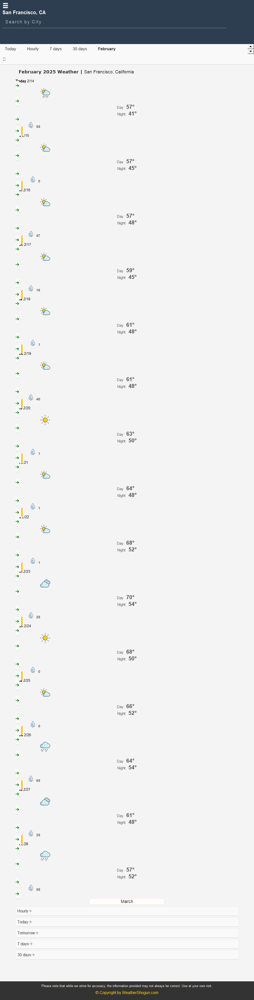

In [26]:
from IPython.display import display, HTML, Image
import imgkit

# URL to fetch
url = "https://weathershogun.com/weather/usa/ca/san-francisco/480/january"

# Display the link
display(HTML(f'<a href="{url}">{url}</a>'))

# Display the content in an iframe
display(HTML(f'''
    <iframe src="{url}" width="400" height="300" style="border: 1px solid black;"></iframe>
'''))

# Convert the webpage to an image
imgkit.from_url(url, 'weather_report.png')

# Display the PNG image
display(Image(filename="weather_report.png"))

## Conclusion
This notebook demonstrated `how to utilize the langchain library and its tools to perform searches and extract useful information`. By leveraging the TavilySearchResults tool, we were able to fetch and process search results effectively. Additionally, web scraping techniques were used to extract and present data in a structured format. This approach can be extended to various use cases requiring automated information retrieval and processing.